In [ ]:
!pip install pyvirtualdisplay gym[atari] pyglet
!apt-get install python-opengl -y
!pip install atari-py
!apt-get install unrar

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 884.3/884.3 kB 14.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 24.0 MB/s eta 0:00:00
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
E: Unable to locate package python-opengl
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 540.6/540.6 kB 11.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for atari-py: filename=atari_py-0.2.9-cp310-cp310-linux_x86_64.whl size=2870427 sha256=ba832faa3033e48420932481a5a8f1287faebb273e0bcbd90be1708904c92385
  Stored in directory: /root/.cache/pip/wheels/75/6f/04/1f3bf5255580101e16ff487564354dddcdd23ec3b43b775b7a
Successfully built atari-py
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
unrar is already the newest version (1:6.1.5-1).
0 upgraded, 0 newly installed, 0 to remove and 45 not upgraded.


In [ ]:
!sudo apt-get install -y xvfb ffmpeg

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
The following additional packages will be installed:
  libfontenc1 libxfont2 libxkbfile1 x11-xkb-utils xfonts-base xfonts-encodings
  xfonts-utils xserver-common
The following NEW packages will be installed:
  libfontenc1 libxfont2 libxkbfile1 x11-xkb-utils xfonts-base xfonts-encodings
  xfonts-utils xserver-common xvfb
0 upgraded, 9 newly installed, 0 to remove and 45 not upgraded.
Need to get 7,813 kB of archives.
After this operation, 11.9 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/main amd64 libfontenc1 amd64 1:1.1.4-1build3 [14.7 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/main amd64 libxfont2 amd64 1:2.0.5-1build1 [94.5 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/main amd64 libxkbfile1 amd64 1:1.1.0-1build3 [71.8 kB]
Get:4 http://archive.ubuntu.com/ubuntu jammy/main a

In [ ]:
# Import ROMS
!wget http://www.atarimania.com/roms/Roms.rar
!unrar x Roms.rar
!python -m atari_py.import_roms /content/ROMS

Streaming output truncated to the last 5000 lines.
Extracting  ROMS/Bobby geht nach Hause (AKA Bobby Is Going Home) (1983) (Quelle) (476.774 5) (PAL).bin       4%  OK 
Extracting  ROMS/Bobby Is Going Home (1983) (Bit Corporation) (PG206).bin       4%  OK 
Extracting  ROMS/Bobby Is Going Home (2600 Screen Search Console) (Jone Yuan Telephonic Enterprise Co).bin       4%  OK 
Extracting  ROMS/Bobby Is Going Home (Fotomania).bin                       4%  OK 
Extracting  ROMS/Bobby Is Going Home (Rentacom).bin                        4%  OK 
Extracting  ROMS/Bobby Is Going Home - Bobby geht Heim (1983) (Bit Corporation) (PG206) (PAL) [demonstration cartridge] ~.bin       4%  OK 
Extracting  ROMS/Bobby Is Going Home - Bobby geht Heim (1983) (Bit Corporation) (PG206) (PAL) ~.bin       4%  OK 
Extracting  ROMS/Bobby Is Going Home - Bobby Vai Para Casa (1983) (CCE) (C-803) (PAL).bin       4%  OK 
Extracting  ROMS/Bobby Is G

In [ ]:
import gym
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt
from ale_py import ALEInterface

/usr/local/lib/python3.10/dist-packages/ale_py/roms/__init__.py:89: DeprecationWarning: Automatic importing of atari-py roms won't be supported in future releases of ale-py. Please migrate over to using `ale-import-roms` OR an ALE-supported ROM package. To make this warning disappear you can run `ale-import-roms --import-from-pkg atari_py.atari_roms`.For more information see: https://github.com/mgbellemare/Arcade-Learning-Environment#rom-management
  ROMS = resolve_roms()


In [ ]:
# Adding Visualization Function
from pyvirtualdisplay import Display
display = Display(visible=0, size=(1024, 768))
display.start()

In [ ]:
from matplotlib import pyplot as plt, animation
from IPython.display import display, HTML
def create_anim(frames, dpi, fps):
    plt.figure(figsize=(frames[0].shape[1] / dpi, frames[0].shape[0] / dpi), dpi=dpi)
    patch = plt.imshow(frames[0])
    def setup():
        plt.axis('off')
    def animate(i):
        patch.set_data(frames[i])
    anim = animation.FuncAnimation(plt.gcf(), animate, init_func=setup, frames=len(frames), interval=fps)
    return anim

def display_anim(frames, dpi=72, fps=60):
    anim = create_anim(frames, dpi, fps)
    return anim.to_jshtml()

def save_anim(frames, filename, dpi=72, fps=60):
    anim = create_anim(frames, dpi, fps)
    anim.save(filename)

class trigger:
    def __init__(self):
        self._trigger = True

    def __call__(self, e):
        return self._trigger

    def set(self, t):
        self._trigger = t

In [ ]:
#display(HTML(display_anim(frames)))
def create_anim_from_disk(save_dir, frame_count, dpi=72, fps=60):
    fig = plt.figure(figsize=(1600 / dpi, 900 / dpi), dpi=dpi)
    ax = fig.add_subplot(111)
    patch = plt.imshow(plt.imread(os.path.join(save_dir, 'frame_0.png')))
    plt.axis('off')

    def animate(i):
        patch.set_data(plt.imread(os.path.join(save_dir, f'frame_{i}.png')))
        return patch,

    anim = animation.FuncAnimation(fig, animate, frames=frame_count, interval=1000/fps, blit=True)
    return anim

In [ ]:
def get_ball_position(state):
    # Extract ball position from the state
    for i in range(90, 185):
        for j in range(10, 150):
            if state[i][j][0] == 200 and state[i][j][1] == 72 and state[i][j][2] == 72:
                return i, j
    return None, None

def get_paddle_position(state):
    # Extract paddle position from the state
    for i in range(189, 194):
        for j in range(10, 150):
            if state[i][j][0] == 200 and state[i][j][1] == 72 and state[i][j][2] == 72:
                return j
    return None

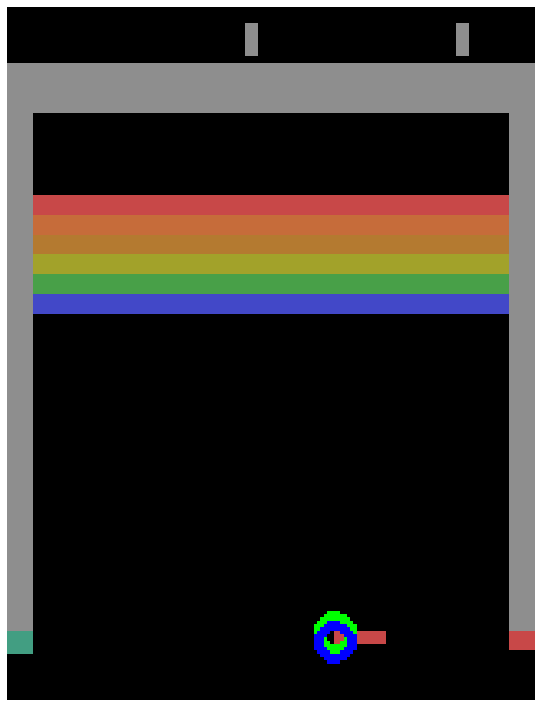

In [ ]:
frame_count = len(os.listdir(save_dir))
anim = create_anim_from_disk(save_dir, frame_count)
HTML(anim.to_jshtml())

## single episode

/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/core.py:43: DeprecationWarning: WARN: The argument mode in render method is deprecated; use render_mode during environment initialization instead.
See here for more information: https://www.gymlibrary.ml/content/api/
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:297: UserWarning: WARN: No render fps was declare

Action: Fire (Release the ball)
Action: 1, Reward: 0.0, Done: False, Ball Position: (None, None), Paddle Position: 99
Action: 3, Reward: 0.0, Done: False, Ball Position: (75, 125), Paddle Position: 99
Action: 3, Reward: 0.0, Done: False, Ball Position: (72, 128), Paddle Position: 92
Action: 3, Reward: 0.0, Done: False, Ball Position: (68, 132), Paddle Position: 71
Action: 2, Reward: 0.0, Done: False, Ball Position: (65, 135), Paddle Position: 53
Action: 2, Reward: 0.0, Done: False, Ball Position: (61, 139), Paddle Position: 55
Action: 3, Reward: 0.0, Done: False, Ball Position: (57, 143), Paddle Position: 76
Action: 3, Reward: 0.0, Done: False, Ball Position: (53, 147), Paddle Position: 75
Action: 3, Reward: 0.0, Done: False, Ball Position: (49, 151), Paddle Position: 53
Action: 2, Reward: 0.0, Done: False, Ball Position: (47, 153), Paddle Position: 41
Action: 0, Reward: 0.0, Done: False, Ball Position: (43, 157), Paddle Position: 43
Action: 3, Reward: 0.0, Done: False, Ball Position: 

FileNotFoundError: [Errno 2] No such file or directory: './frames/frame_1.png'

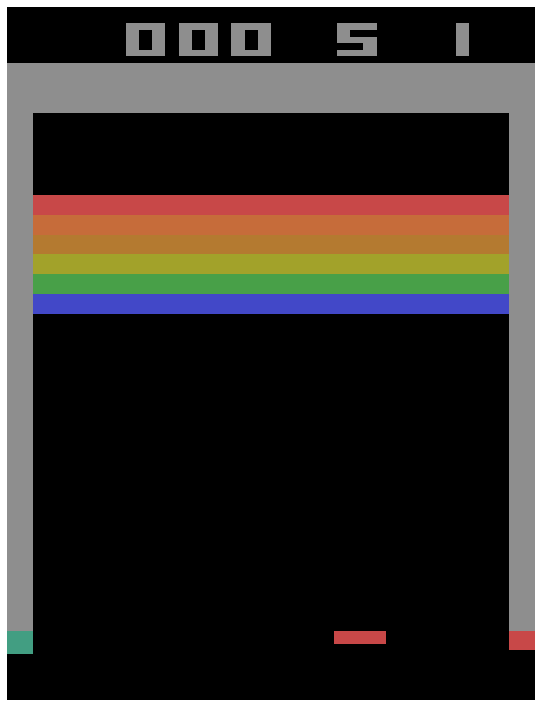

In [ ]:
# Set up environment
environment_name = 'Breakout-v4'
env = gym.make(environment_name, render_mode='rgb_array')

frames = []
save_interval = 30  # Reduce the save interval for quick debugging
save_dir = './frames'
os.makedirs(save_dir, exist_ok=True)

frame_counter = 0

# Run a single episode for debugging
state = env.reset()
state = state[0]  # Reset returns a tuple, we need the first element
done = False
score = 0
ball_released = False

while not done and frame_counter < 100:
  frame = env.render(mode='rgb_array')
  frames.append(frame)
  ball_y, ball_x = get_ball_position(frame)
  paddle_x = get_paddle_position(frame)

  if not ball_released:
    action = 1  # Fire (Release the ball)
    ball_released = True
    print("Action: Fire (Release the ball)")
  elif paddle_x is not None and ball_y is not None:
    if ball_x < paddle_x:
      action = 3  # Move left
    elif ball_x > paddle_x:
      action = 2  # Move right
    else:
      action = 0  # Stay still
  else:
    action = 1  # No-op if positions are not detected

  n_state, reward, done, info = env.step(action)
  score += reward
  print(f"Action: {action}, Reward: {reward}, Done: {done}, Ball Position: ({ball_x}, {ball_y}), Paddle Position: {paddle_x}")
  #print(f"Action taken: {action}, Reward: {reward}")

  if len(frames) >= save_interval:
    for i, frame in enumerate(frames):
      cv2.imwrite(os.path.join(save_dir, f'frame_{frame_counter + i}.png'), cv2.cvtColor(frame, cv2.COLOR_RGB2BGR))
      frame_counter += len(frames)
      frames.clear()

print(f"Score: {score}")

# Save remaining frames
for i, frame in enumerate(frames):
  cv2.imwrite(os.path.join(save_dir, f'frame_{frame_counter + i}.png'), cv2.cvtColor(frame, cv2.COLOR_RGB2BGR))

env.close()

# Create and display animation
frame_count = len(os.listdir(save_dir))
anim = create_anim_from_disk(save_dir, frame_count)
HTML(anim.to_jshtml())

In [ ]:
# Set up environment
environment_name = 'Breakout-v4'
env = gym.make(environment_name, render_mode='rgb_array')

frames = []
save_interval = 30  # Reduce the save interval for quick debugging
save_dir = './frames'
os.makedirs(save_dir, exist_ok=True)

frame_counter = 0

# Run a single episode for debugging
state = env.reset()
state = state[0]  # Reset returns a tuple, we need the first element
done = False
score = 0
ball_released = False

while not done:
    frame = env.render(mode='rgb_array')
    frame = np.array(frame)
    frames.append(frame)
    ball_y, ball_x = get_ball_position(frame)
    paddle_x = get_paddle_position(frame)

    if not ball_released:
        action = 1  # Fire (Release the ball)
        ball_released = True
        print("Action: Fire (Release the ball)")
    elif paddle_x is not None and ball_y is not None:
        if ball_x < paddle_x:
            action = 3  # Move left
        elif ball_x > paddle_x:
            action = 2  # Move right
        else:
            action = 0  # Stay still
    else:
        action = 1  # No-op if positions are not detected

    n_state, reward, done, info = env.step(action)
    score += reward
    print(f"Action: {action}, Reward: {reward}, Done: {done}, Ball Position: ({ball_x}, {ball_y}), Paddle Position: {paddle_x}")

    if len(frames) >= save_interval:
        for i, frame in enumerate(frames):
            cv2.imwrite(os.path.join(save_dir, f'frame_{frame_counter + i}.png'), cv2.cvtColor(frame, cv2.COLOR_RGB2BGR))
        frame_counter += len(frames)
        frames.clear()

print(f"Score: {score}")

# Save remaining frames
for i, frame in enumerate(frames):
    cv2.imwrite(os.path.join(save_dir, f'frame_{frame_counter + i}.png'), cv2.cvtColor(frame, cv2.COLOR_RGB2BGR))

env.close()

# Create and display animation
frame_count = len(os.listdir(save_dir))
anim = create_anim_from_disk(save_dir, frame_count)
HTML(anim.to_jshtml())

Output hidden; open in https://colab.research.google.com to view.

## multiple episodes

In [ ]:
# Set up environment
environment_name = 'Breakout-v4'
env = gym.make(environment_name, render_mode='rgb_array')

frames = []
episodes = 5
save_interval = 50
save_dir = './frames'
os.makedirs(save_dir, exist_ok=True)

frame_counter = 0

for episode in range(1, episodes + 1):
    obs = env.reset()
    print(f"Episode {episode} started")
    done = False
    score = 0
    ball_released = False

    while not done:
        frame = env.render(mode='rgb_array')
        frame = np.array(frame)
        frames.append(frame)

        ball_x, ball_y = get_ball_position(frame)
        paddle_x = get_paddle_position(frame)

        if not ball_released:
            action = 1  # Fire (Release the ball)
            ball_released = True
        elif paddle_x is not None and ball_x is not None:
            if ball_y < paddle_x:
                action = 3  # Move left
            elif ball_y > paddle_x:
                action = 2  # Move right
            else:
                action = 0  # Stay still
        else:
            action = env.action_space.sample()  # Random action if positions are not detected

        obs, reward, done, info = env.step(action)
        score += reward

        if len(frames) >= save_interval:
            for i, frame in enumerate(frames):
                cv2.imwrite(os.path.join(save_dir, f'frame_{frame_counter + i}.png'), cv2.cvtColor(frame, cv2.COLOR_RGB2BGR))
            frame_counter += len(frames)
            frames.clear()

        # Print debug information
        print(f"Episode: {episode}, Action: {action}, Reward: {reward}, Done: {done}, Ball Position: ({ball_x}, {ball_y}), Paddle Position: {paddle_x}")

    print(f"Episode: {episode} Score: {score}")

# Save remaining frames
for i, frame in enumerate(frames):
    cv2.imwrite(os.path.join(save_dir, f'frame_{frame_counter + i}.png'), cv2.cvtColor(frame, cv2.COLOR_RGB2BGR))

env.close()

# Create and display animation
frame_count = len(os.listdir(save_dir))
anim = create_anim_from_disk(save_dir, frame_count)
HTML(anim.to_jshtml())

Output hidden; open in https://colab.research.google.com to view.

## random actions

In [ ]:
# Set up environment
environment_name = 'Breakout-v4'
env = gym.make(environment_name, render_mode='rgb_array')

frames = []
episodes = 5
save_interval = 50
save_dir = './frames'
os.makedirs(save_dir, exist_ok=True)

frame_counter = 0

for episode in range(1, episodes + 1):
    state = env.reset()
    print(f"Episode {episode} started")
    done = False
    score = 0

    while not done:
        frame = env.render(mode='rgb_array')
        frames.append(frame)

        action = env.action_space.sample()  # Take a random action
        n_state, reward, done, info = env.step(action)
        score += reward

        if len(frames) >= save_interval:
            for i, frame in enumerate(frames):
                cv2.imwrite(os.path.join(save_dir, f'frame_{frame_counter + i}.png'), cv2.cvtColor(frame, cv2.COLOR_RGB2BGR))
            frame_counter += len(frames)
            frames.clear()

    print(f"Episode: {episode} Score: {score}")

# Save remaining frames
for i, frame in enumerate(frames):
    cv2.imwrite(os.path.join(save_dir, f'frame_{frame_counter + i}.png'), cv2.cvtColor(frame, cv2.COLOR_RGB2BGR))

env.close()

# Create and display animation
frame_count = len(os.listdir(save_dir))
anim = create_anim_from_disk(save_dir, frame_count)
HTML(anim.to_jshtml())

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
!rm -rf frames

In [ ]:
def visualize_frame(frame):
    plt.imshow(frame)
    plt.axis('off')
    plt.show()

def get_ball_position(state):
    for i in range(34, 194):
        for j in range(16, 144):
            if state[i, j, 0] == 200 and state[i, j, 1] == 72 and state[i, j, 2] == 72:
                return i, j
    return None, None

def get_paddle_position(state):
    for i in range(189, 194):
        for j in range(16, 144):
            if state[i, j, 0] == 200 and state[i, j, 1] == 72 and state[i, j, 2] == 72:
                return j
    return None

# environment_name = 'Breakout-v4'
# env = gym.make(environment_name, render_mode='rgb_array')

# state = env.reset()
# state = state[0]  # Reset returns a tuple, we need the first element
# frame = env.render(mode='rgb_array')
# visualize_frame(frame)

# env.close()

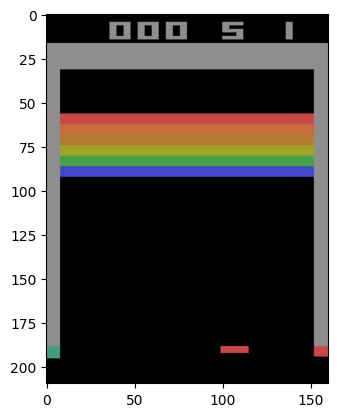

In [ ]:
import matplotlib.pyplot as plt

def onclick(event):
    ix, iy = int(event.xdata), int(event.ydata)
    print(f'Pixel coordinates: ({ix}, {iy}) - RGB values: {frame[iy, ix]}')
    return ix, iy

fig, ax = plt.subplots()
ax.imshow(frame)
cid = fig.canvas.mpl_connect('button_press_event', onclick)
plt.show()


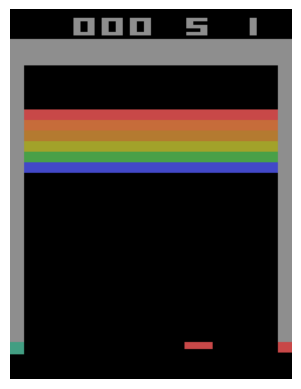

Pixel values for a specific region (Ball area):
Pixel at (100,16): [0 0 0]
Pixel at (100,17): [0 0 0]
Pixel at (100,18): [0 0 0]
Pixel at (100,19): [0 0 0]
Pixel at (100,20): [0 0 0]
Pixel at (100,21): [0 0 0]
Pixel at (100,22): [0 0 0]
Pixel at (100,23): [0 0 0]
Pixel at (100,24): [0 0 0]
Pixel at (100,25): [0 0 0]
Pixel at (100,26): [0 0 0]
Pixel at (100,27): [0 0 0]
Pixel at (100,28): [0 0 0]
Pixel at (100,29): [0 0 0]
Pixel at (100,30): [0 0 0]
Pixel at (100,31): [0 0 0]
Pixel at (100,32): [0 0 0]
Pixel at (100,33): [0 0 0]
Pixel at (100,34): [0 0 0]
Pixel at (100,35): [0 0 0]
Pixel at (100,36): [0 0 0]
Pixel at (100,37): [0 0 0]
Pixel at (100,38): [0 0 0]
Pixel at (100,39): [0 0 0]
Pixel at (100,40): [0 0 0]
Pixel at (100,41): [0 0 0]
Pixel at (100,42): [0 0 0]
Pixel at (100,43): [0 0 0]
Pixel at (100,44): [0 0 0]
Pixel at (100,45): [0 0 0]
Pixel at (100,46): [0 0 0]
Pixel at (100,47): [0 0 0]
Pixel at (100,48): [0 0 0]
Pixel at (100,49): [0 0 0]
Pixel at (100,50): [0 0 0]
Pixel a

In [ ]:
def print_pixel_values(frame, start_row, end_row, start_col, end_col):
    for i in range(start_row, end_row):
        for j in range(start_col, end_col):
            print(f'Pixel at ({i},{j}): {frame[i,j]}')

environment_name = 'Breakout-v4'
env = gym.make(environment_name, render_mode='rgb_array')

state = env.reset()
state = state[0]  # Reset returns a tuple, we need the first element
frame = env.render(mode='rgb_array')
visualize_frame(frame)

# Adjust these values to inspect different regions of the frame
print("Pixel values for a specific region (Ball area):")
print_pixel_values(frame, 100, 150, 16, 110)  # Example region

# print("Pixel values for a specific region (Paddle area):")
# print_pixel_values(frame, 180, 195, 90, 110)  # Example region

env.close()

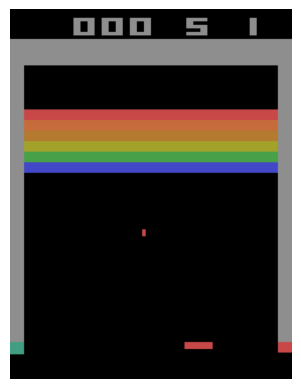

Pixel values for a specific region (Paddle area):
Pixel at (190,16): [0 0 0]
Pixel at (190,17): [0 0 0]
Pixel at (190,18): [0 0 0]
Pixel at (190,19): [0 0 0]
Pixel at (190,20): [0 0 0]
Pixel at (190,21): [0 0 0]
Pixel at (190,22): [0 0 0]
Pixel at (190,23): [0 0 0]
Pixel at (190,24): [0 0 0]
Pixel at (190,25): [0 0 0]
Pixel at (190,26): [0 0 0]
Pixel at (190,27): [0 0 0]
Pixel at (190,28): [0 0 0]
Pixel at (190,29): [0 0 0]
Pixel at (190,30): [0 0 0]
Pixel at (190,31): [0 0 0]
Pixel at (190,32): [0 0 0]
Pixel at (190,33): [0 0 0]
Pixel at (190,34): [0 0 0]
Pixel at (190,35): [0 0 0]
Pixel at (190,36): [0 0 0]
Pixel at (190,37): [0 0 0]
Pixel at (190,38): [0 0 0]
Pixel at (190,39): [0 0 0]
Pixel at (190,40): [0 0 0]
Pixel at (190,41): [0 0 0]
Pixel at (190,42): [0 0 0]
Pixel at (190,43): [0 0 0]
Pixel at (190,44): [0 0 0]
Pixel at (190,45): [0 0 0]
Pixel at (190,46): [0 0 0]
Pixel at (190,47): [0 0 0]
Pixel at (190,48): [0 0 0]
Pixel at (190,49): [0 0 0]
Pixel at (190,50): [0 0 0]
Pixel

In [ ]:
def print_pixel_values(frame, start_row, end_row, start_col, end_col):
    for i in range(start_row, end_row):
        for j in range(start_col, end_col):
            print(f'Pixel at ({i},{j}): {frame[i,j]}')

environment_name = 'Breakout-v4'
env = gym.make(environment_name, render_mode='rgb_array')

state = env.reset()
state = state[0]  # Reset returns a tuple, we need the first element
env.render(mode='rgb_array')

# Release the ball to start the game
action = 1  # Fire (Release the ball)
n_state, reward, done, info = env.step(action)

# Render the frame after releasing the ball
frame = env.render(mode='rgb_array')
visualize_frame(frame)

# # Adjust these values to inspect different regions of the frame
# print("Pixel values for a specific region (Ball area):")
# print_pixel_values(frame, 90, 150, 16, 144)  # Example region

print("Pixel values for a specific region (Paddle area):")
print_pixel_values(frame, 190, 195, 16, 144)  # Example region

env.close()